In [1]:
import pandas as pd
from skimage.io import imread
from utils import get_new_mask, get_border, hex_to_array, draw_type_mask

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [2]:
cell_types = ['T_cells', 'NK_cells', 'B_cells', 
              'Endothelial_cells','Macrophages', 
              'Epithelial_cells', 'Fibroblasts ', 
              'Neutrophils', 'Undefined']
colors = ["#ffeb3b", "#ab47bc", "#1e88e5",
          "#4caf50","#EE5061","#ff5722",
          "#607d8b", "#FFA7FF", '#000000']

In [3]:
import matplotlib.pyplot as plt

In [4]:
cell_df = pd.read_csv(f"./test_matrix.csv", sep=",")
cell_df = cell_df[cell_df['cell'] != '(nan, nan)']
mask = imread(f"test.tif")
print(mask.shape)
new_mask = get_new_mask(mask, cell_df, cell_types)
m0 = new_mask
back = imread(f'./test.png')
print(back.shape)
figsize = (mask.shape[0] * 0.05, mask.shape[1] * 0.05)
fig, ax = plt.subplots(figsize=figsize)
output_path = f'./cell_type.pdf'
draw_type_mask(ax, m0, colors=colors, back = back, labels=cell_types, output_path=output_path)
ax.axis('off')

(2937, 2874)
0
(2937, 2874)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 2873.5, 2936.5, -0.5)

In [4]:
import numpy as np
from skimage.color import label2rgb

In [9]:
def draw_type_mask_border(ax, mask, colors, labels, output_path, bg_color="#000000", back=None, border=None):
    colors_ = [hex_to_array(i) for i in colors]
    bg_color = hex_to_array(bg_color)
    rgb_img = label2rgb(mask, colors=colors_, bg_color=bg_color)

    if border is not None:
        rgb_img[border, :] = [1, 1, 1]

    if back is not None:
        back_ratio = 0.4
        back_ = (back - back.min()) / (back.max() - back.min())
        back_ = np.stack([back_, back_, back_], axis=2)
        rgb_img = back_ * back_ratio + rgb_img * (1 - back_ratio)
        ax.imshow(rgb_img)
    else:
        ax.imshow(rgb_img)

    ax.grid(False)
    patches = [plt.Rectangle((0,0),1,1, fc=color) for color in colors]
    ax.legend(patches, labels, loc=2, bbox_to_anchor=(1.05,1.0), borderaxespad=0.)
    ax.axis('off')
    plt.savefig(output_path, format='pdf')
    plt.show()


In [12]:
cell_df = pd.read_csv(f"./test_matrix.csv", sep=",")
cell_df = cell_df[cell_df['cell'] != '(nan, nan)']
mask = imread(f"test.tif")
print(mask.shape)

new_mask = get_new_mask(mask, cell_df, cell_types)
border = get_border(new_mask)

back = imread(f'./test.png')
print(back.shape)

figsize = (mask.shape[0] * 0.05, mask.shape[1] * 0.05)
fig, ax = plt.subplots(figsize=figsize)
output_path = f'./cell_type—border.pdf'

draw_type_mask_border(ax, new_mask, colors=colors, back=back, labels=cell_types, output_path=output_path, border=border)


(2937, 2874)
0
(2937, 2874)


In [7]:
def draw_type_mask_border(ax, mask, colors, labels, output_path, bg_color="#000000", back=None, border=None):
    colors_ = [hex_to_array(i) for i in colors]
    bg_color = hex_to_array(bg_color)
    rgb_img = label2rgb(mask, colors=colors_, bg_color=bg_color)

    # If border is provided, apply a soft color with transparency
    if border is not None:
        border_color = np.array([0.8, 0.8, 0.8])  # Light grey color
        alpha = 0.5  # Transparency level
        rgb_img[border] = rgb_img[border] * (1 - alpha) + border_color * alpha

    if back is not None:
        back_ratio = 0.4
        back_ = (back - back.min()) / (back.max() - back.min())
        back_ = np.stack([back_, back_, back_], axis=2)
        rgb_img = back_ * back_ratio + rgb_img * (1 - back_ratio)
        ax.imshow(rgb_img)
    else:
        ax.imshow(rgb_img)

    ax.grid(False)
    patches = [plt.Rectangle((0,0),1,1, fc=color) for color in colors]
    ax.legend(patches, labels, loc=2, bbox_to_anchor=(1.05,1.0), borderaxespad=0.)
    ax.axis('off')
    plt.savefig(output_path, format='pdf')
    plt.show()

(2937, 2874)
0
(2937, 2874)


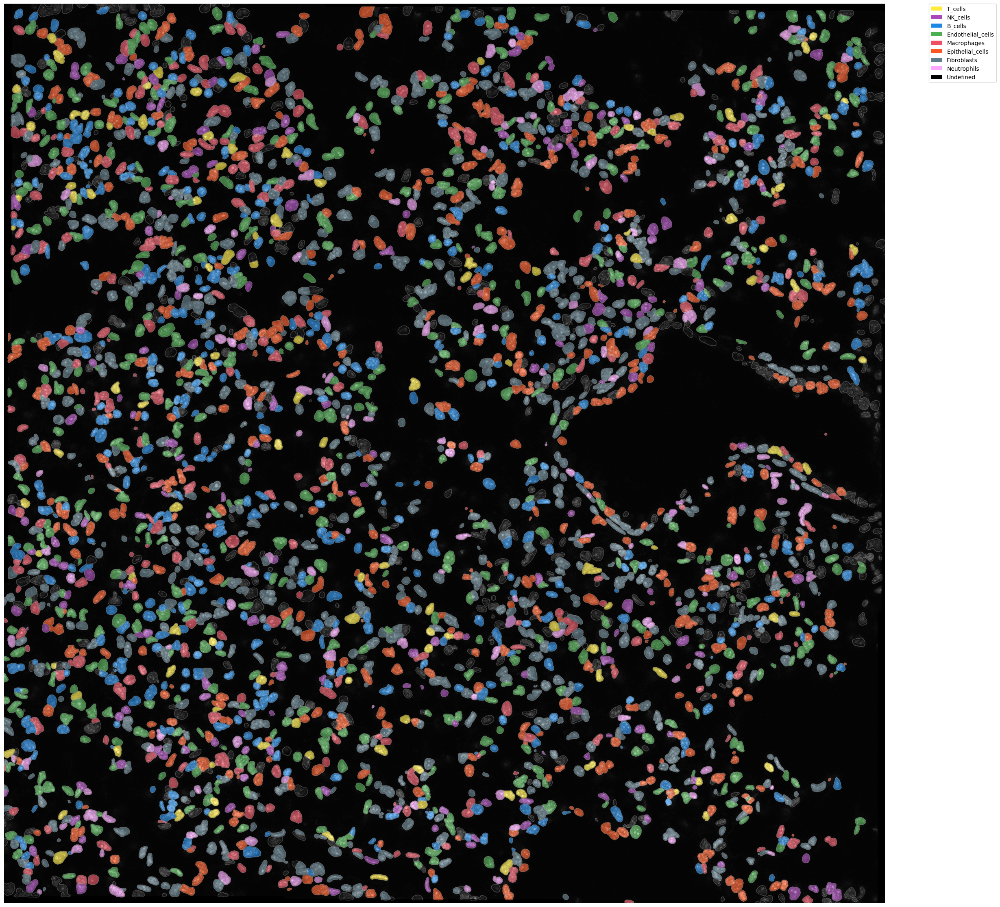

In [8]:
cell_df = pd.read_csv(f"./test_matrix.csv", sep=",")
cell_df = cell_df[cell_df['cell'] != '(nan, nan)']
mask = imread(f"test.tif")
print(mask.shape)

new_mask = get_new_mask(mask, cell_df, cell_types)
border = get_border(new_mask)

back = imread(f'./test.png')
print(back.shape)

figsize = (mask.shape[0] * 0.01, mask.shape[1] * 0.01)
fig, ax = plt.subplots(figsize=figsize)
output_path = f'./cell_type—border.pdf'

draw_type_mask_border(ax, new_mask, colors=colors, back=back, labels=cell_types, output_path=output_path, border=border)
